In [2]:
import scanpy as sc
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp
import scIB
import seaborn as sns

/home/icb/daniel.strobl/conda_scib/envs/scIB-python-2/lib/python3.7/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex


In [3]:
plt.rcParams["font.family"] = "Source Sans 3"

In [4]:
import warnings
warnings.filterwarnings("ignore")

In [5]:
plt.rcParams['figure.figsize'] = (15, 15)

In [6]:
plt.rcParams.update({'axes.titlesize': 'x-large'})

In [7]:
sns.set(font_scale=1.5, style='white')

In [7]:
sns.set_context('poster')

In [8]:
sns.set(font_scale=1.7)

In [9]:
sns.set_context("poster", rc={"axes.titlesize":60}) 

In [11]:
import pandas as pd

In [31]:
sns.set_style(style='white')

In [8]:
sns.set_palette(palette=sc.pl.palettes.godsnot_102)

# User input

In [21]:
method_mapping = {'scGen*':'scgen', 'scANVI*':'scanvi', 'Seurat v3 RPCA':'seuratrpca', 'Scanorama':'scanorama', 'fastMNN':'fastmnn',
       'Conos':'conos', 'scVI':'scvi', 'Seurat v3 CCA':'seurat', 'MNN':'mnn', 'BBKNN':'bbknn', 'ComBat':'combat',
       'trVAE':'trvae', 'Harmony':'harmony', 'DESC':'desc', 'Unintegrated':'unintegrated', 'SAUCIE':'saucie', 'LIGER':'liger'}
output_mapping = {'gene':'full', 'embed':'embed', 'graph':'knn'}
feature_mapping = {'FULL':'full_feature', 'HVG':'hvg'}


In [16]:
def get_best_worst(df):
    top = df.groupby(['Method','Output']).first().sort_values(by='Overall Score', ascending=False).head(n=4)
    worst = df.groupby(['Method','Output']).last().sort_values(by='Overall Score', ascending=True).head(n=4)
    paths_top = {}
    paths_worst = {}
    for i in top.index:
        name = i[0]+" ("+i[1]+") "+top.loc[i]['Scaling']+"/"+top.loc[i]['Features']
        paths_top[name] = top.loc[i]['Scaling']+"/"+feature_mapping[top.loc[i]['Features']]+"/"+method_mapping[i[0]]+'_'+output_mapping[i[1]]+'.csv'
    for i in worst.index:
        name = i[0]+" ("+i[1]+") "+worst.loc[i]['Scaling']+"/"+worst.loc[i]['Features']
        paths_worst[name] = worst.loc[i]['Scaling']+"/"+feature_mapping[worst.loc[i]['Features']]+"/"+method_mapping[i[0]]+'_'+output_mapping[i[1]]+'.csv'
    return(paths_top, paths_worst)

# Read files

In [17]:
def read_emb(csv, base):
    best, worst = get_best_worst(csv)
    best_emb = {}
    best_cat = {}
    worst_emb = {}
    for i in best.keys():
        try:
            best_emb[i]= pd.read_csv(base+best[i])
            #best_cat[i] = pd.read_csv(base.replace('embeddings', 'cat')+best[i])
            best_emb[i] = best_emb[i].join(pd.read_csv(base.replace('embeddings', 'cat')+best[i]), rsuffix='_r')
        except (OSError, pd.errors.EmptyDataError):
            print(i+' is missing')
            best_emb[i] = pd.DataFrame()
    for i in worst.keys():
        try:
            worst_emb[i] = pd.read_csv(base+worst[i])
            worst_emb[i] = worst_emb[i].join(pd.read_csv(base.replace('embeddings', 'cat')+worst[i]), rsuffix='_r')
        except (OSError, pd.errors.EmptyDataError):
            worst_emb[i] = pd.DataFrame()
            print(i+' is missing')
            
        #worst_emb[i] = worst_emb[i][worst_emb[i].columns[worst_emb[i].columns.duplicated(keep=False)]]
    return best_emb, worst_emb#, best_cat

# Plotting functions

In [18]:
# Visualization loop
def viz_emb(emb_best, emb_worst, var, axs, start=1, var_list=None, dimnames=False):
    for i in emb_best:
        if len(emb_best[i].columns) != 0:
            if var_list is not None:
                if (var_list.unique() == (emb_best[i][var].unique())).all() == False:
                    print('changed var')
                    emb_best[i][var]=var_list
            if dimnames==False:
                dim1 = emb_best[i].columns[3]
                dim2 = emb_best[i].columns[4]
            else:
                dim1 = dimnames[0]
                dim2 = dimnames[1]
            #print(var)
            g = sns.scatterplot(data=emb_best[i], x=dim1, y=dim2, hue=var, marker='.', linewidth=0, s=15, ax=axs[start], legend=False)
            sns.despine(left=True, bottom=True)
            #plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
            g.set(yticks=[])
            g.set(xticks=[])
            g.set_ylabel("")
            g.set_xlabel("")
            g.set_title(i, fontsize=20)

        start+=1

    for i in emb_worst:
        
        if len(emb_worst[i].columns)!=0:
            if var_list is not None:
                if (var_list.unique() == emb_worst[i][var].unique()).all() == False:
                    print('changed var')
                    emb_worst[i][var]=var_list
            if dimnames==False:
                dim1 = emb_worst[i].columns[3]
                dim2 = emb_worst[i].columns[4]
            else:
                dim1 = dimnames[0]
                dim2 = dimnames[1]
            g = sns.scatterplot(data=emb_worst[i], x=dim1, y=dim2, hue=var, marker='.', linewidth=0, s=15, ax=axs[start], legend=False)
            sns.despine(left=True, bottom=True)
            #plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
            g.set(yticks=[])
            g.set(xticks=[])
            g.set_ylabel("")
            g.set_xlabel("")
            g.set_title(i, fontsize=20)
        start+=1
        
def make_grid(rows = 2):
    fig = plt.figure(constrained_layout=True, figsize=[40,rows*12])
    gs = fig.add_gridspec(rows*2, 7)
    axs = []
    axs.append(fig.add_subplot(gs[0:2,0:2]))
    axs.append(fig.add_subplot(gs[0,2]))
    axs.append(fig.add_subplot(gs[0,3]))
    axs.append(fig.add_subplot(gs[0,4]))
    axs.append(fig.add_subplot(gs[0,5]))
    axs.append(fig.add_subplot(gs[1,2]))
    axs.append(fig.add_subplot(gs[1,3]))
    axs.append(fig.add_subplot(gs[1,4]))
    axs.append(fig.add_subplot(gs[1,5]))
    axs.append(fig.add_subplot(gs[0:2,6]))
    
    axs.append(fig.add_subplot(gs[2:4,0:2]))
    axs.append(fig.add_subplot(gs[2,2]))
    axs.append(fig.add_subplot(gs[2,3]))
    axs.append(fig.add_subplot(gs[2,4]))
    axs.append(fig.add_subplot(gs[2,5]))
    axs.append(fig.add_subplot(gs[3,2]))
    axs.append(fig.add_subplot(gs[3,3]))
    axs.append(fig.add_subplot(gs[3,4]))
    axs.append(fig.add_subplot(gs[3,5]))
    axs.append(fig.add_subplot(gs[2:4,6]))
    if rows > 2:
        axs.append(fig.add_subplot(gs[4:6,0:2]))
        axs.append(fig.add_subplot(gs[4,2]))
        axs.append(fig.add_subplot(gs[4,3]))
        axs.append(fig.add_subplot(gs[4,4]))
        axs.append(fig.add_subplot(gs[4,5]))
        axs.append(fig.add_subplot(gs[5,2]))
        axs.append(fig.add_subplot(gs[5,3]))
        axs.append(fig.add_subplot(gs[5,4]))
        axs.append(fig.add_subplot(gs[5,5]))
        axs.append(fig.add_subplot(gs[4:6,6]))
        if rows == 4:
            axs.append(fig.add_subplot(gs[6:8,0:2]))
            axs.append(fig.add_subplot(gs[6,2]))
            axs.append(fig.add_subplot(gs[6,3]))
            axs.append(fig.add_subplot(gs[6,4]))
            axs.append(fig.add_subplot(gs[6,5]))
            axs.append(fig.add_subplot(gs[7,2]))
            axs.append(fig.add_subplot(gs[7,3]))
            axs.append(fig.add_subplot(gs[7,4]))
            axs.append(fig.add_subplot(gs[7,5]))
            axs.append(fig.add_subplot(gs[6:8,6]))
        if rows > 4:
            return ValueError('more than 4 rows not supported')
    return fig, axs

In [19]:
import string
def draw_figure(csv, base, addPlots=[]):
    #fig, axs = make_grid()
    best_emb, worst_emb = read_emb(csv, base)
    unintegrated_emb = pd.read_csv(base+"/unscaled/full_feature/unintegrated_full.csv").join(pd.read_csv(base.replace('embeddings', 'cat')+"unscaled/full_feature/unintegrated_full.csv"), rsuffix='_r')
    ct_key = unintegrated_emb.columns[1]
    batch_key = unintegrated_emb.columns[2]
    
    if len(addPlots)==0:
        fig, ax = make_grid()
    else:
        fig, ax = make_grid(2+len(addPlots))
    g = sns.scatterplot(data=unintegrated_emb, x='UMAP1', y='UMAP2', hue=ct_key, marker='.', linewidth=0, s=15, ax=ax[0],legend=False)
    sns.despine(left=True, bottom=True)
    #g.legend(bbox_to_anchor=(3.5, 0), loc=10, borderaxespad=0., fontsize=15)
    g.set(yticks=[])
    g.set(xticks=[])
    g.set_ylabel("")
    g.set_xlabel("")
    g.set_title('Cell Type', fontsize=40)
    g.text(-12.5, 12.5, 'a', fontsize=30)
    
    g = sns.scatterplot(data=unintegrated_emb, x='UMAP1', y='UMAP2', hue=ct_key, marker='.', linewidth=0, s=0, ax=ax[9])
    sns.despine(left=True, bottom=True)
    g.legend(loc=6, borderaxespad=0., fontsize=15, ncol=1, frameon=False, title="")
    g.set(yticks=[])
    g.set(xticks=[])
    g.set_ylabel("")
    g.set_xlabel("")
    viz_emb(best_emb, worst_emb, ct_key, ax)
    
    
    g = sns.scatterplot(data=unintegrated_emb, x='UMAP1', y='UMAP2', hue=batch_key, marker='.', linewidth=0, s=15, ax=ax[10],legend=False)
    sns.despine(left=True, bottom=True)
    #g.legend(bbox_to_anchor=(3.5, 0), loc=10, borderaxespad=0., fontsize=15)
    g.set(yticks=[])
    g.set(xticks=[])
    g.set_ylabel("")
    g.set_xlabel("")
    g.set_title('Batch', fontsize=40)
    g.text(-12.5, 12.5, 'b', fontsize=30)
    
    g = sns.scatterplot(data=unintegrated_emb, x='UMAP1', y='UMAP2', hue=batch_key, marker='.', linewidth=0, s=0, ax=ax[19])
    sns.despine(left=True, bottom=True)
    g.legend(loc=6, borderaxespad=0., fontsize=15, ncol=1, frameon=False, title="")
    g.set(yticks=[])
    g.set(xticks=[])
    g.set_ylabel("")
    g.set_xlabel("")
    viz_emb(best_emb, worst_emb, batch_key, ax, start=11, var_list= unintegrated_emb[batch_key])
    
    ax_it=20
    sub_letter = 2
    for i in addPlots:
        #print(unintegrated_emb[i])
        g = sns.scatterplot(data=unintegrated_emb, x='UMAP1', y='UMAP2', hue=i, marker='.', linewidth=0, s=15, ax=ax[ax_it],legend=False)
        sns.despine(left=True, bottom=True)
        #g.legend(bbox_to_anchor=(3.5, 0), loc=10, borderaxespad=0., fontsize=15)
        g.set(yticks=[])
        g.set(xticks=[])
        g.set_ylabel("")
        g.set_xlabel("")
        g.set_title(i, fontsize=40)
        g.text(-12.5, 12.5, string.ascii_lowercase[sub_letter], fontsize=30)
    
        g = sns.scatterplot(data=unintegrated_emb, x='UMAP1', y='UMAP2', hue=i, marker='.', linewidth=0, s=0, ax=ax[ax_it+9])
        sns.despine(left=True, bottom=True)
        g.legend(loc=6, borderaxespad=0., fontsize=15, ncol=1, frameon=False, title="")
        g.set(yticks=[])
        g.set(xticks=[])
        g.set_ylabel("")
        g.set_xlabel("")
        viz_emb(best_emb, worst_emb, i, ax, start=ax_it+1, var_list= unintegrated_emb[i])
        ax_it = ax_it+10
        sub_letter = sub_letter+1

    fig.savefig(base+'/figure_400.png', dpi=400)
    fig.savefig(base+'/figure_150.png', dpi=150)
    #fig.savefig(base+'/figure.svg')
    
    '''
    fig_2, axs_2 = make_grid()
    sc.pl.umap(a_pre, title="Cell type", color=ct, frameon=False, ax=axs_2[0])
    viz(a_best, a_worst, ct, axs=axs_2)
    return a_best, a_worst'''

changed var


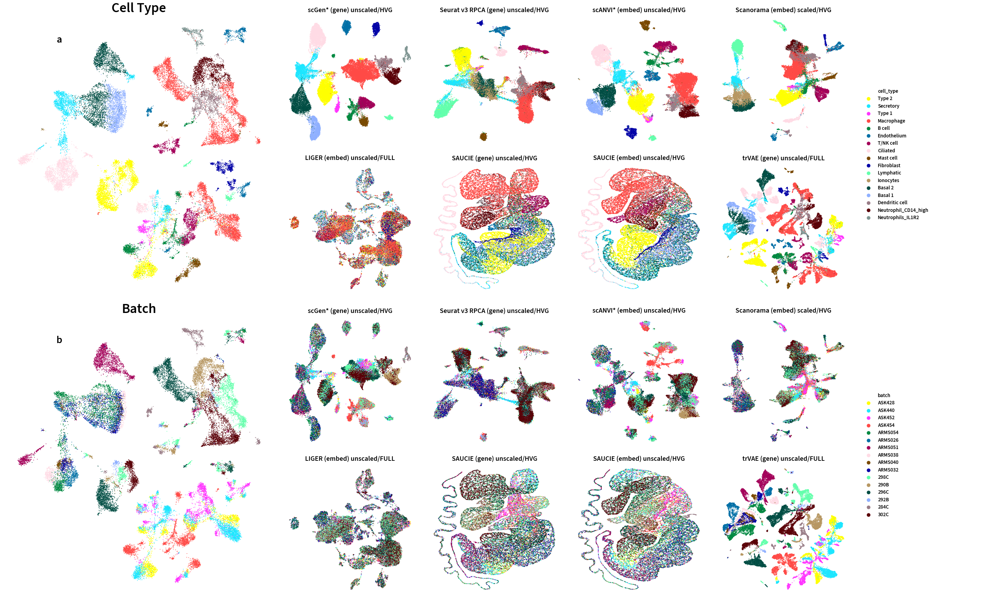

In [150]:
draw_figure(pd.read_csv('~/lung_atlas_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/lung_atlas/embeddings/')

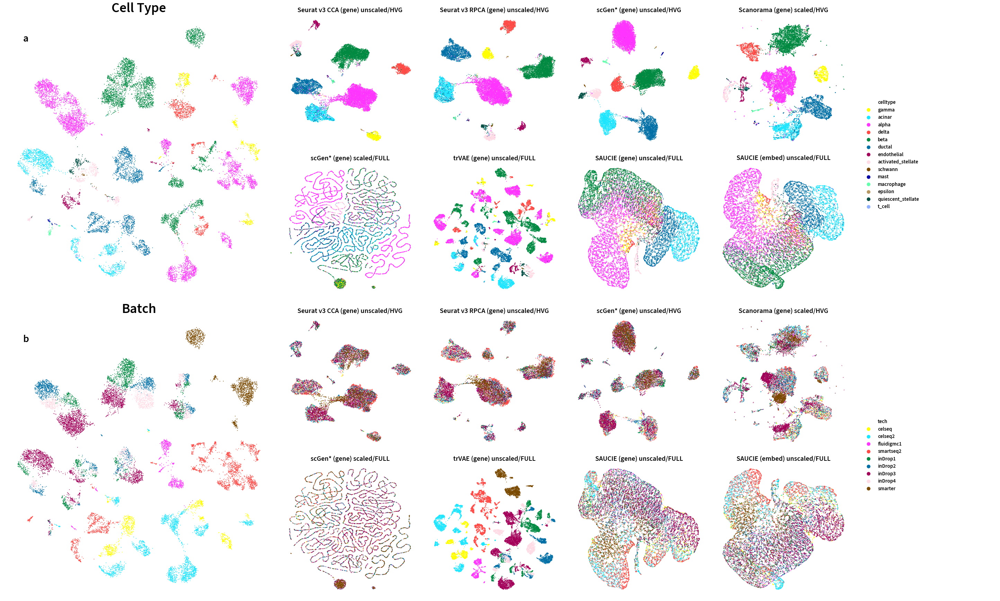

In [151]:
draw_figure(pd.read_csv('~/pancreas_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/pancreas/embeddings/')

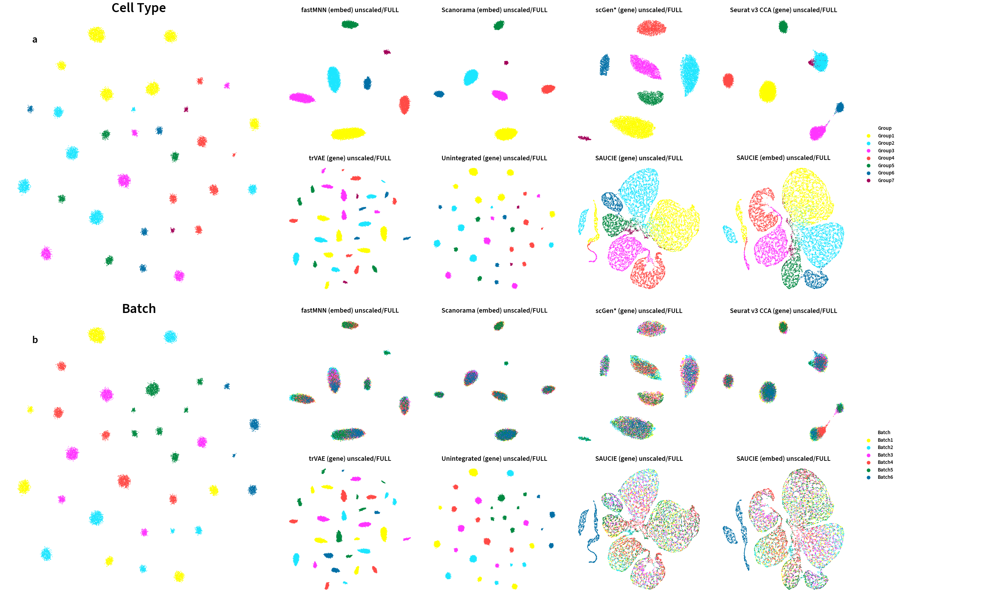

In [152]:
draw_figure(pd.read_csv('~/simulations_1_1_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/simulations_1_1/embeddings/')

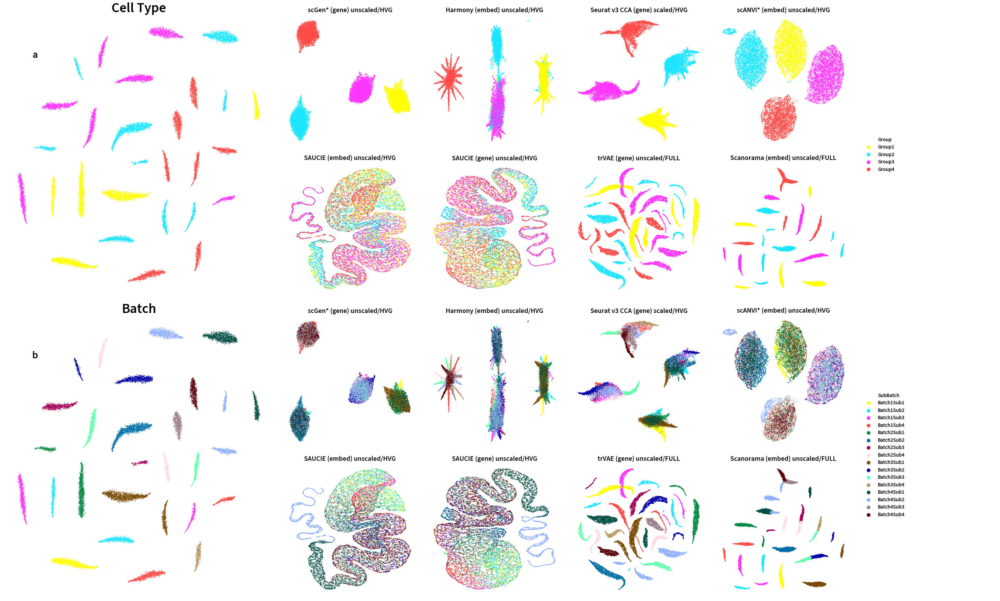

In [153]:
draw_figure(pd.read_csv('~/simulations_2_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/simulations_2/embeddings/')

changed var


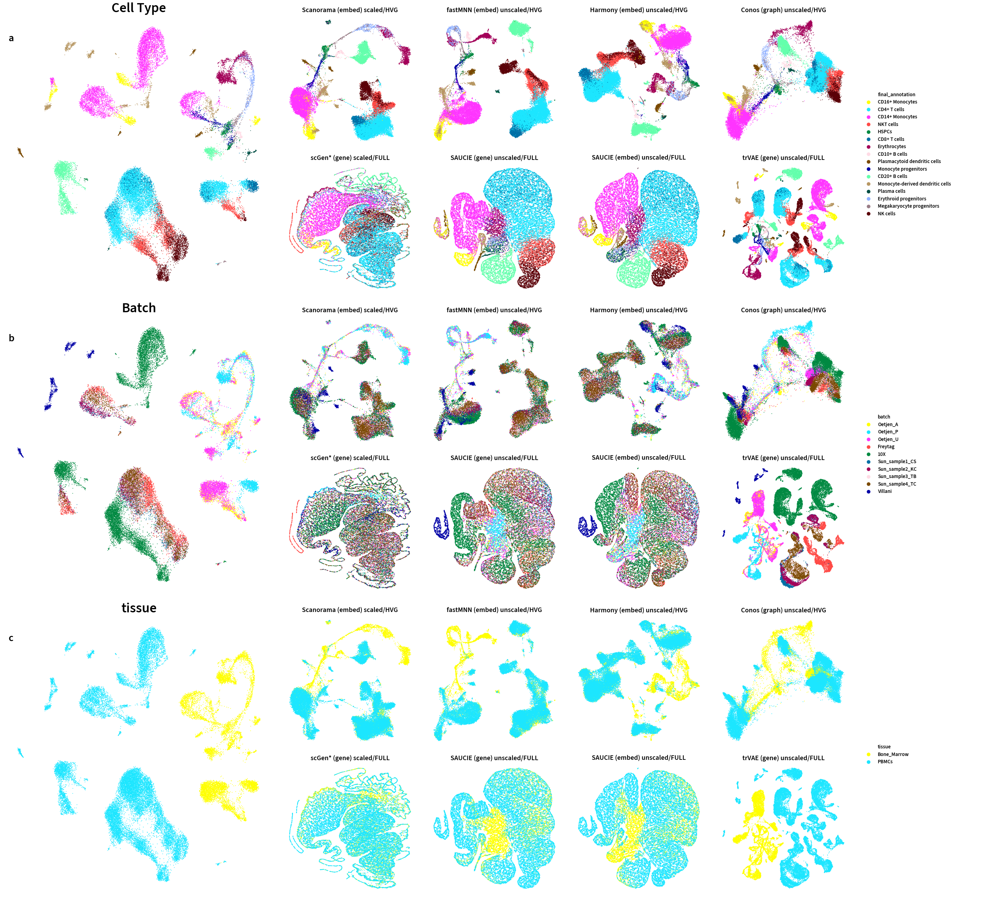

In [154]:
draw_figure(pd.read_csv('~/immune_cell_hum_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/immune_cell_hum/embeddings/',['tissue'])

changed var


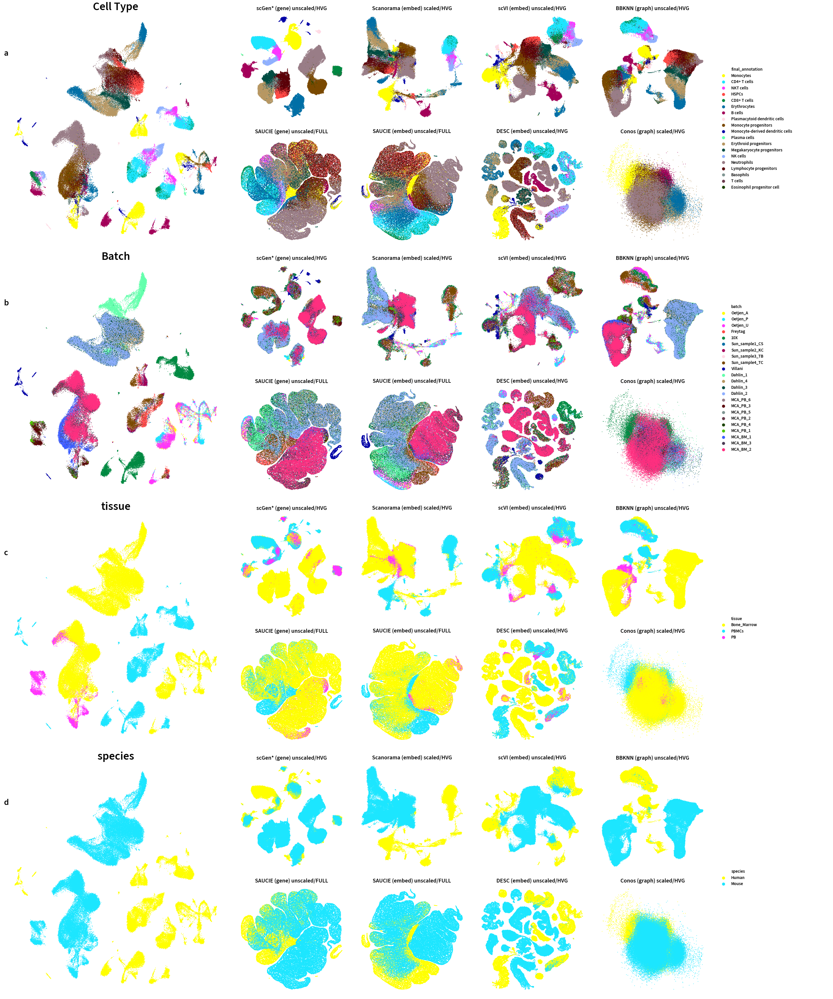

In [155]:
draw_figure(pd.read_csv('~/immune_cell_hum_mou_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/immune_cell_hum_mou/embeddings/',['tissue', 'species'])

Scanorama (gene) scaled/FULL is missing


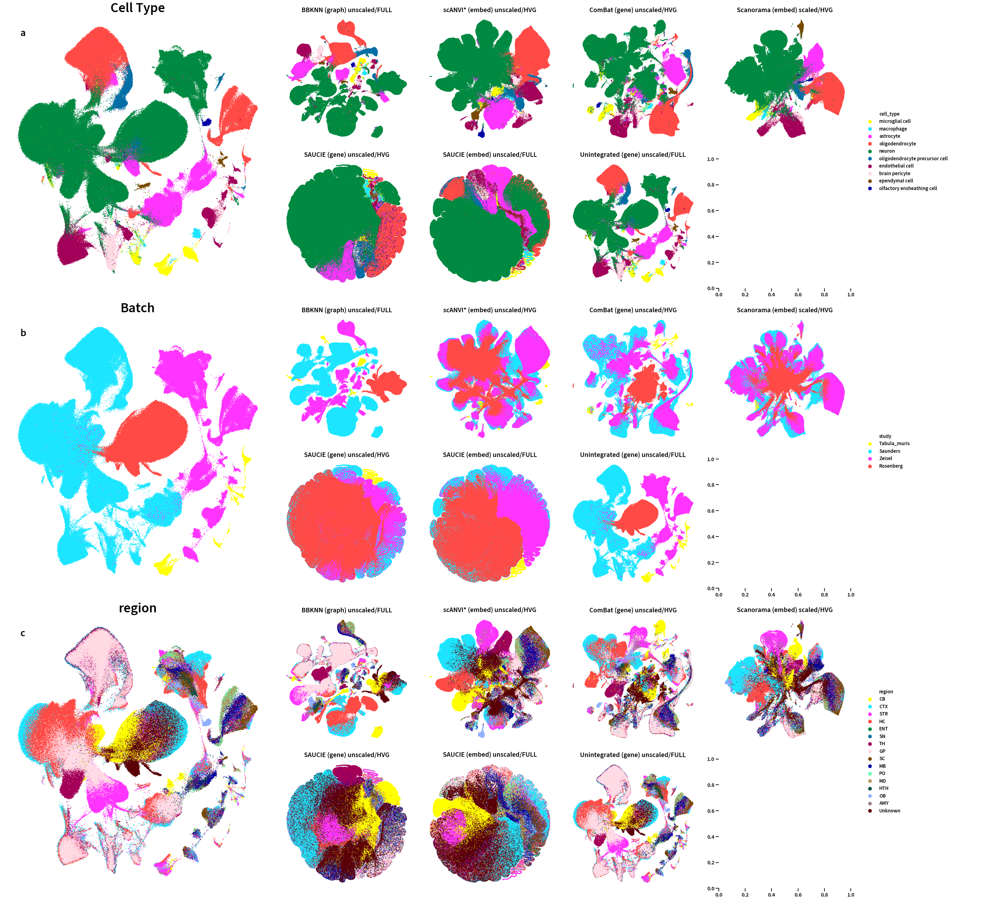

In [175]:
draw_figure(pd.read_csv('~/mouse_brain_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/mouse_brain/embeddings/',['region'])

# Trajectory plots

In [9]:
def get_best_worst_adata(df, base):
    top = df.groupby(['Method','Output']).first().sort_values(by='Overall Score', ascending=False).head(n=4)
    worst = df.groupby(['Method','Output']).last().sort_values(by='Overall Score', ascending=True).head(n=4)
    paths_top = {}
    paths_worst = {}
    for i in top.index:
        name = i[0]+" ("+i[1]+") "+top.loc[i]['Scaling']+"/"+top.loc[i]['Features']
        paths_top[name] = sc.read(base+top.loc[i]['Scaling']+"/"+feature_mapping[top.loc[i]['Features']]+"/"+method_mapping[i[0]]+'.h5ad')
    for i in worst.index:
        name = i[0]+" ("+i[1]+") "+worst.loc[i]['Scaling']+"/"+worst.loc[i]['Features']
        paths_worst[name] = sc.read(base+worst.loc[i]['Scaling']+"/"+feature_mapping[worst.loc[i]['Features']]+"/"+method_mapping[i[0]]+'.h5ad')
    return(paths_top, paths_worst)

In [184]:
adatas = get_best_worst_adata(pd.read_csv('~/immune_cell_hum_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/immune_cell_hum/integration/')

In [14]:
def gen_dpt(adatas, unintegrated):
    adatas_sub_best = {}
    adatas_sub_worst = {}
    for i in adatas[0].keys():
        _type = i.split(' ')[1][1:-1]
        adatas_uni_sub, adatas_sub_best[i] = trajectory_plot(unintegrated, adatas[0][i],  'final_annotation', _type)
    for i in adatas[1].keys():
        _type = i.split(' ')[1][1:-1]
        _, adatas_sub_worst[i] = trajectory_plot(unintegrated, adatas[1][i], 'final_annotation', _type)
    return adatas_sub_best, adatas_sub_worst, adatas_uni_sub

In [23]:
ihm_unintegrated = sc.read('/storage/groups/ml01/projects/2020_scIB_malte.luecken/immune_cell_hum/prepare/unscaled/full_feature/adata_pre.h5ad')

In [39]:
sub = gen_dpt(get_best_worst_adata(pd.read_csv('~/immune_cell_hum_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/immune_cell_hum/integration/'), ihm_unintegrated)

PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


In [43]:
sc.pp.neighbors(sub[2])
sc.tl.diffmap(sub[2])
sc.tl.umap(sub[2])

         Falling back to preprocessing with `sc.pp.pca` and default params.


In [61]:
sub[2].obs['test'] = sub[2].obsm['X_diffmap'][:,1]

In [65]:
np.corrcoef(sub[2].obs['test'], sub[2].obsm['X_diffmap'][:,2])[0,1]

0.0002813864438780157

In [66]:
def get_reductions(sub, batch, ct):
    sc.pp.neighbors(sub[2])
    sc.tl.diffmap(sub[2])
    sc.tl.umap(sub[2])
    uni_emb = pd.DataFrame(data=sub[2].obsm['X_diffmap'][:,1:3], index=sub[2].obs_names, columns=['DIFF1', 'DIFF2'])
    uni_emb['ct']=sub[2].obs[ct]
    uni_emb['batch']=sub[2].obs[batch]
    uni_emb['dpt']=sub[2].obs['dpt_pseudotime']
    uni_emb['UMAP2']=sub[2].obsm['X_umap'][:,1]
    emb_best = {}
    for i in sub[0].keys():
        print(i)
        sc.tl.diffmap(sub[0][i])
        sc.tl.umap(sub[0][i])
        dim1 = np.argmax(abs(np.corrcoef(uni_emb['DIFF1'],sub[0][i].obsm['X_diffmap'].T)[0][1:]))
        dim2 = np.argmax(abs(np.corrcoef(uni_emb['DIFF2'],sub[0][i].obsm['X_diffmap'].T)[0][1:]))
        emb_best[i] = pd.DataFrame(data=sub[0][i].obsm['X_diffmap'][:,[dim1, dim2]], index=sub[2].obs_names, columns=['DIFF1', 'DIFF2'])
        if np.corrcoef(uni_emb['DIFF1'],emb_best[i]['DIFF1'])[0,1]<0:
            emb_best[i]['DIFF1'] = emb_best[i]['DIFF1']*-1
        if np.corrcoef(uni_emb['DIFF2'],emb_best[i]['DIFF2'])[0,1]:
            emb_best[i]['DIFF2'] = emb_best[i]['DIFF2']*-1
        emb_best[i]['ct']=sub[0][i].obs[ct]
        emb_best[i]['batch']=sub[0][i].obs[batch]
        emb_best[i]['dpt']=sub[0][i].obs['dpt_after']
        emb_best[i]['UMAP1']=sub[0][i].obsm['X_umap'][:,0]
        emb_best[i]['UMAP2']=sub[0][i].obsm['X_umap'][:,1]
    emb_worst = {}    
    for i in sub[1].keys():
        print(i)
        sc.tl.diffmap(sub[1][i])
        sc.tl.umap(sub[1][i])
        dim1 = np.argmax(abs(np.corrcoef(uni_emb['DIFF1'],sub[1][i].obsm['X_diffmap'].T)[0][1:]))
        dim2 = np.argmax(abs(np.corrcoef(uni_emb['DIFF2'],sub[1][i].obsm['X_diffmap'].T)[0][1:]))
        emb_worst[i] = pd.DataFrame(data=sub[1][i].obsm['X_diffmap'][:,[dim1, dim2]], index=sub[2].obs_names, columns=['DIFF1', 'DIFF2'])
        if np.corrcoef(uni_emb['DIFF1'],emb_worst[i]['DIFF1'])[0,1]<0:
            emb_worst[i]['DIFF1'] = emb_worst[i]['DIFF1']*-1
        if np.corrcoef(uni_emb['DIFF2'],emb_worst[i]['DIFF2'])[0,1]:
            emb_worst[i]['DIFF2'] = emb_worst[i]['DIFF2']*-1
        emb_worst[i]['ct']=sub[1][i].obs[ct]
        emb_worst[i]['batch']=sub[1][i].obs[batch]
        emb_worst[i]['dpt']=sub[1][i].obs['dpt_after']
        emb_worst[i]['UMAP1']=sub[1][i].obsm['X_umap'][:,0]
        emb_worst[i]['UMAP2']=sub[1][i].obsm['X_umap'][:,1]
    return emb_best, emb_worst, uni_emb
    

In [67]:
red = get_reductions(gen_dpt(get_best_worst_adata(pd.read_csv('~/immune_cell_hum_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/immune_cell_hum/integration/'), ihm_unintegrated), 'batch', 'final_annotation')

PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


         Falling back to preprocessing with `sc.pp.pca` and default params.
Scanorama (embed) scaled/HVG
fastMNN (embed) unscaled/HVG
Harmony (embed) unscaled/HVG
Conos (graph) unscaled/HVG


KeyError: 'params'

In [31]:
import string
def draw_figure_trajectory(red, addPlots=['dpt', 'batch', 'ct']):
    print(addPlots)
    #fig, axs = make_grid()
    #best_emb, worst_emb = read_emb(csv, base)
    #unintegrated_emb = pd.read_csv(base+"/unscaled/full_feature/unintegrated_full.csv").join(pd.read_csv(base.replace('embeddings', 'cat')+"unscaled/full_feature/unintegrated_full.csv"), rsuffix='_r')
    red = red
    best_emb = red[0]
    worst_emb = red[1]
    unintegrated_emb = red[2]
    #ct_key = 'ct'
    #batch_key = 'batch'
    
    if True:#len(addPlots)==0:
        fig, ax = make_grid(3)
    else:
        print(addPlots)
        fig, ax = make_grid(2+len(addPlots))
    
    ax_it=0
    sub_letter = 0
    for i in addPlots:
        #print(unintegrated_emb[i])
        g = sns.scatterplot(data=unintegrated_emb, x='DIFF1', y='DIFF2', hue=i, marker='.', linewidth=0, s=15, ax=ax[ax_it],legend=False)
        sns.despine(left=True, bottom=True)
        #g.legend(bbox_to_anchor=(3.5, 0), loc=10, borderaxespad=0., fontsize=15)
        g.set(yticks=[])
        g.set(xticks=[])
        g.set_ylabel("")
        g.set_xlabel("")
        g.set_title(i, fontsize=40)
        g.text(-12.5, 12.5, string.ascii_lowercase[sub_letter], fontsize=30)
    
        g = sns.scatterplot(data=unintegrated_emb, x='DIFF1', y='DIFF2', hue=i, marker='.', linewidth=0, s=0, ax=ax[ax_it+9])
        sns.despine(left=True, bottom=True)
        g.legend(loc=6, borderaxespad=0., fontsize=15, ncol=1, frameon=False, title="")
        g.set(yticks=[])
        g.set(xticks=[])
        g.set_ylabel("")
        g.set_xlabel("")
        viz_emb(best_emb, worst_emb, i, ax, start=ax_it+1, dimnames=['DIFF1', 'DIFF2'])
        ax_it = ax_it+10
        sub_letter = sub_letter+1

    #fig.savefig(base+'/figure_400.png', dpi=400)
    fig.savefig('/home/icb/daniel.strobl/tra_fig.png', dpi=150)

In [32]:
draw_figure_trajectory(red)

['dpt', 'batch', 'ct']


ValueError: Image size of 116726x102594 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 2880x2592 with 30 Axes>

In [269]:
u = sub[2]

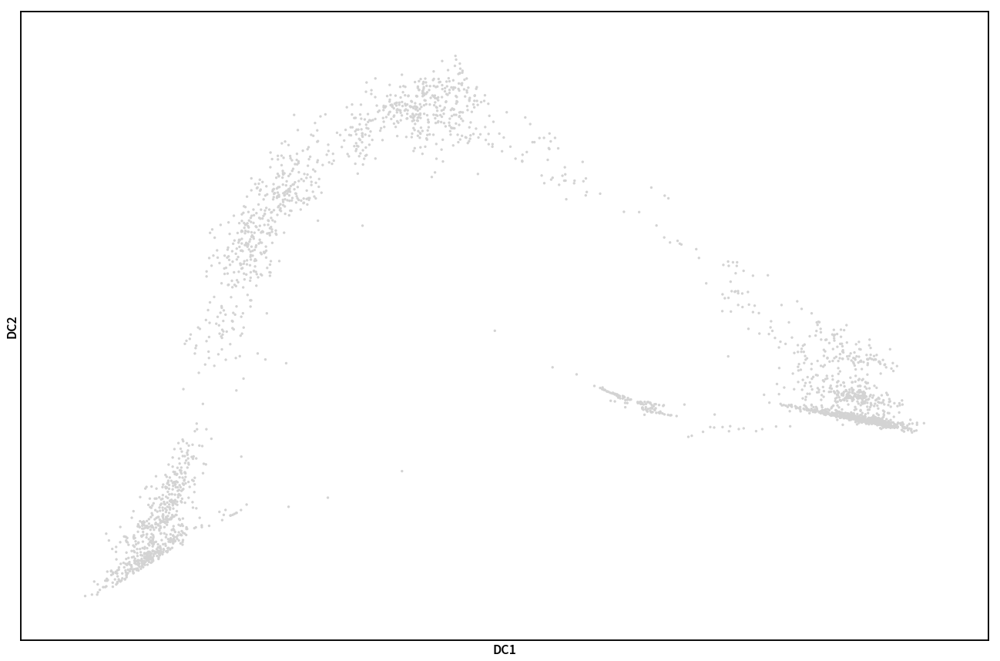

In [272]:
sc.pp.neighbors(u)
sc.tl.diffmap(u)

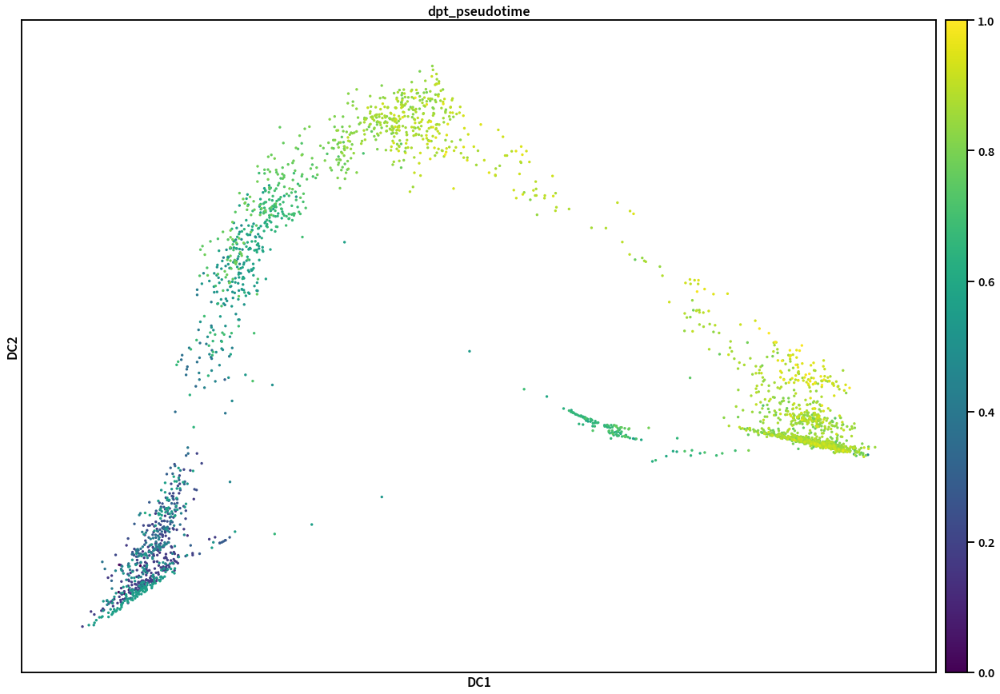

In [316]:
sc.pl.diffmap(u, color='dpt_pseudotime')

In [286]:
import scipy.stats

In [304]:
for i in a.obsm['X_diffmap']
scipy.stats.pearsonr(u.obsm['X_diffmap'][:,1], a.obsm['X_diffmap'][:,4])[0]

0.8244130865313997

In [326]:
np.argmax(np.corrcoef(u.obsm['X_diffmap'][:,1],a.obsm['X_diffmap'].T)[0][1:])

4

In [327]:
np.argmax(np.corrcoef(u.obsm['X_diffmap'][:,2],a.obsm['X_diffmap'].T)[0][1:])

5

In [310]:
scipy.stats.pearsonr(u.obsm['X_diffmap'][:,2], a.obsm['X_diffmap'][:,5])[0]

0.7982897824637709

In [266]:
a = sub[0]['Scanorama (embed) scaled/HVG']

In [314]:
sc.tl.diffmap(a)

TypeError: diffmap() got an unexpected keyword argument 'color'

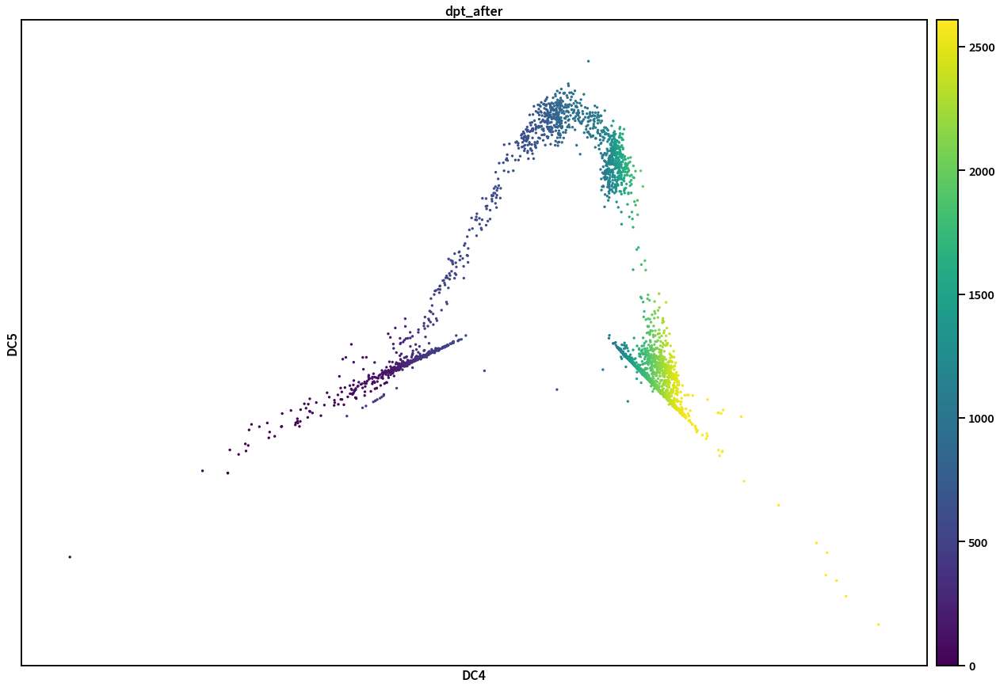

In [312]:
sc.pl.diffmap(a, components=[4,5], color='dpt_after')

In [13]:
from scipy.sparse.csgraph import connected_components

def run_pp(adata, adata_int, type_, changeCT = False):
    # DATA REDUCTION
    # select options according to type
    
    if changeCT:
        adata.obs.loc[adata.obs.final_annotation == 'Lymphocyte progenitors', 'final_annotation'] = 'HSPCs'
        adata_int.obs.loc[adata_int.obs.final_annotation == 'Lymphocyte progenitors', 'final_annotation'] = 'HSPCs'
        
    if len(set(adata.obs_names).difference(set(adata_int.obs_names))) > 0:
        #rename adata_int.obs[batch_key] labels by overwriting them with the pre-integration labels
        #new_obs_names = ['-'.join(idx.split('-')[:-1]) for idx in adata_int.obs_names]

        if len(set(adata.obs_names).difference(set(new_obs_names))) == 0:
            adata_int.obs_names = new_obs_names
        else:
            print(set(adata.obs_names).difference(set(new_obs_names)))
            raise ValueError('obs_names changed after integration!')
    
    if adata.n_vars > adata_int.n_vars:
        n_hvgs = None
    
    # case 1: full expression matrix, default settings
    precompute_pca = True
    recompute_neighbors = True
    embed = 'X_pca'
    n_hvgs=2000
    
    # distinguish between subsetted and full expression matrix
    # compute HVGs only if output is not already subsetted
    if adata.n_vars > adata_int.n_vars:
        n_hvgs = None
    
    # case 2: embedding output
    if (type_ == "embed"):
        n_hvgs = None
        embed = "X_emb"
        # legacy check
        if ('emb' in adata_int.uns) and (adata_int.uns['emb']):
            adata_int.obsm["X_emb"] = adata_int.obsm["X_pca"].copy()
    
    # case3: kNN graph output
    elif (type_ == "graph"):
        n_hvgs = None
        precompute_pca = False
        recompute_neighbors = False
    
    sc.pp.filter_genes(adata_int, min_cells=1)
    scIB.preprocessing.reduce_data(adata_int,
                                   n_top_genes=n_hvgs,
                                   neighbors=recompute_neighbors, use_rep=embed,
                                   pca=precompute_pca, umap=False)
    
def get_root(adata_pre, adata_post, ct_key, dpt_dim=3):
    
    n_components, adata_post.obs['neighborhood'] = connected_components(csgraph=adata_post.uns['neighbors']['connectivities'], directed=False, return_labels=True)
    
    start_clust = adata_pre.obs.groupby([ct_key]).mean()['dpt_pseudotime'].idxmin()
    min_dpt = adata_pre.obs[adata_pre.obs[ct_key] == start_clust].index
    #print(min_dpt)
    max_neigh = adata_post.obs[adata_post.obs['neighborhood']== adata_post.obs['neighborhood'].value_counts().idxmax()].index
    min_dpt = [value for value in min_dpt if value in max_neigh]
    
    adata_post_sub = adata_post[adata_post.obs['neighborhood']== adata_post.obs['neighborhood'].value_counts().idxmax()]
    
    min_dpt = [adata_post_sub.obs_names.get_loc(i) for i in min_dpt]
    
    # compute Diffmap for adata_post
    sc.tl.diffmap(adata_post_sub)
    
    # determine most extreme cell in adata_post Diffmap
    min_dpt_cell = np.zeros(len(min_dpt))
    for dim in np.arange(dpt_dim):
        
        diffmap_mean = adata_post_sub.obsm["X_diffmap"][:, dim].mean()
        diffmap_min_dpt = adata_post_sub.obsm["X_diffmap"][min_dpt, dim]
        
        # choose optimum function
        if diffmap_min_dpt.mean() < diffmap_mean:
            opt = np.argmin
        else:
            opt = np.argmax
        # count opt cell
        if len(diffmap_min_dpt) == 0:
            #raise RootCellError('No root cell in largest component')
            return False
        min_dpt_cell[opt(diffmap_min_dpt)] += 1
    
    # root cell is cell with max vote
    adata_post_sub.uns['iroot'] = min_dpt[np.argmax(min_dpt_cell)]
    return adata_post_sub

def trajectory_plot(adata_pre, adata_post, label_key, type_, changeCT=False):
    #if len(set(adata_pre.obs_names).difference(set(adata_post.obs_names))) > 0:
        #rename adata_int.obs[batch_key] labels by overwriting them with the pre-integration labels
        #new_obs_names = ['-'.join(idx.split('-')[:-1]) for idx in adata_post.obs_names]
        #new_obs_names = adata_post.obs_names.str[-2]

        #if len(set(adata_pre.obs_names).difference(set(new_obs_names))) == 0:
            #adata_post.obs_names = new_obs_names
        #else:
        #    #print((set(adata_pre.obs_names).difference(set(new_obs_names))))
        #    print(new_obs_names[:10])
        #    raise ValueError('obs_names changed after integration!')
    adata_post.obs_names = adata_pre.obs_names
    run_pp(adata_pre, adata_post, type_, changeCT=changeCT)
    
    cell_subset = adata_pre.obs.index[adata_pre.obs["dpt_pseudotime"].notnull()]
    adata_pre_sub = adata_pre[cell_subset]
    adata_post_sub = adata_post[cell_subset]
    
    adata_post_sub2 = get_root(adata_pre_sub, adata_post_sub, label_key)
    
    if adata_post_sub2:
        sc.tl.dpt(adata_post_sub2)
        #adata_post_sub.obs['dpt_pseudotime'][adata_post_sub.obs['dpt_pseudotime']>1]=0
        #return (adata_post_sub.obs['dpt_pseudotime'].corr(adata_pre_sub.obs['dpt_pseudotime'], 'spearman')+1)/2
        #adata_pre_sub.obs['dpt_after'] = adata_post_sub.obs['dpt_pseudotime']
    
        adata_post_sub.obs['dpt_after'] = pd.Series(range(len(adata_post_sub2.obs)), index=adata_post_sub2.obs.sort_values('dpt_pseudotime').index)
    else:
        adata_post_sub.obs['dpt_after'] = 0
        #adata_post_wo = adata_post_sub[adata_post_sub.obs.dpt_pseudotime!=0]
    """    if 'conos' in label:
            #sc.tl.draw_graph(adata_post_sub)
            #sc.pl.umap(adata_post_sub, color='dpt_after', title=label, show=False, frameon=False, ax=ax)
        else:    
            #sc.tl.umap(adata_post_sub)
            #sc.pl.umap(adata_post_sub, color='dpt_after', title=label, show=False, frameon=False, ax=ax)

    else:
        #adata_pre_draw.obs['dpt_after'] = pd.Series(range(len(adata_pre_draw.obs)), index=adata_post_sub.obs.sort_values('dpt_pseudotime').index)
        #sc.tl.umap(adata_pre_draw)
        #sc.pl.umap(adata_pre_draw, color='dpt_after', title=label, show=False, frameon=False, ax=ax)"""
    return adata_pre_sub, adata_post_sub

In [ ]:
# Visualization loop
def make_trajectories(unintegrated, adatas_best, adatas_worst, var, axs, diffmap=False):
    #fig, axs = plt.subplots(2, 4, figsize=(40,16))
    start = 1
    for key in adatas_best:
        print(key)
        dat = adatas_best[key]
        fig_t = None
        if diffmap:
            dat_tmp = dat[dat.obs['dpt_pseudotime']>= 0]
            dat_tmp = dat_tmp[dat_tmp.obs.dpt_pseudotime<1]
            sc.tl.diffmap(dat_tmp)
            sc.pl.diffmap(dat_tmp, color=var, size=10, title=key, legend_loc="", legend_fontsize='small', ax=axs[start], show=False, frameon=False, components=[0,3])
        elif 'con'in key:
            print('conos draw graph')
            sc.pl.draw_graph(dat, color=var, size=10, title=key, legend_loc="", legend_fontsize='small', ax=axs[start], show=False, frameon=False)
        else:
            sc.pl.umap(dat, color=var, size=10, title=key, legend_loc="", legend_fontsize='small', ax=axs[start], show=False, frameon=False)
        fig_t = plt.gcf()
        if len(fig_t.axes)==11:
            plt.delaxes(fig_t.axes[-1])
        #fig_t.tight_layout()
        start+=1
    #start=0
    for key in adatas_worst:
        dat = adatas_worst[key]
        
        if diffmap:
            dat_tmp = dat[dat.obs['dpt_pseudotime']>= 0]
            dat_tmp = dat_tmp[dat_tmp.obs.dpt_pseudotime<1]
            sc.tl.diffmap(dat_tmp)
            sc.pl.diffmap(dat_tmp, color=var, size=10, title=key, legend_loc="", legend_fontsize='small', ax=axs[start], show=False, frameon=False, components=[0,3])
        elif 'con'in key:
            print('conos draw graph')
            sc.pl.draw_graph(dat, color=var, size=10, title=key, legend_loc="", legend_fontsize='small', ax=axs[start], show=False, frameon=False)
        else:
            sc.pl.umap(dat, color=var, size=10, title=key, legend_loc="", legend_fontsize='small', ax=axs[start], show=False, frameon=False)
        fig_t = plt.gcf()
        if len(fig_t.axes)==11:
            plt.delaxes(fig_t.axes[-1])
        #fig_t.tight_layout()
        start+=1
    #plt.savefig('figures/integrated.svg')
        #sc.pl.umap(dat, color=ct_key, size=20, title=key)